<a href="https://colab.research.google.com/github/Juntolli/comp215/blob/main/Deforestation_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Imports section

In [ ]:
%matplotlib inline

import time
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
from scipy.signal import correlate2d

matplotlib.rc('animation', html='jshtml')

I’ve long heard about the Amazon rainforest’s tipping point, a threshold beyond which deforestation reduces the forested area so much that the ecosystem can no longer sustain itself, leading to collapse.

Inspired by this idea, I built a cellular automaton model to simulate deforestation and explore its impact on forest sustainability.

In essence, I want to answer two key questions:

1.	**How much deforestation is needed to push a forest past its tipping point into collapse?**

At this tipping point, the forest begins to lose its remaining area at an accelerated rate—faster than the rate of deforestation alone—triggering a domino effect of collapse.

2.	**When would a ban on deforestation be effective in preventing total collapse?**

If the forest does reach this tipping point, timing the intervention would be crucial on saving the forest. Understanding the dynamics of collapse can help identify the critical moment for implementing conservation measures to avoid irreversible damage.

This model aims to clarify the relationship between deforestation and forest sustainability, providing insights into the conditions under which a forest can collapse and when policy interventions might be most effective.

*Code for animation:*

In [ ]:
# Qualitative colour map with value 0 set to white
tab20_mod = matplotlib.colormaps['tab20']
tab20_mod.colors = ((1,1,1,1), *tab20_mod.colors[1:])

def plot_2d_array(array, axes=None, title='', cmap=tab20_mod, **options):
    """
    Plot the 2D array as an image on the given axes  1's will be dark blue, 0's will be light blue.

    :param axes: the axes to plot on, or None to use the `plt.gca()` (current axes)
    :param options: keyword arguments passed directly to `plt.imshow()`
           see https://matplotlib.org/stable/api/_as_gen/matplotlib.axes.Axes.imshow.html
    """
    axes = axes or plt.gca()  # If not axes are provided, draw on current axes
    axes.set_title(title)
    # Turn off axes labels and tick marks
    axes.tick_params(axis='both', which='both', bottom=False, top=False, left=False, right=False ,
                     labelbottom=False, labeltop=False, labelleft=False, labelright=False,)
    # Defaults for displaying a "matrix" with hard-pixel boundaries and (0,0) at top-left
    options = {**dict(interpolation='nearest', origin='upper'), **options}
    axes.imshow(array, cmap=cmap, **options)

In [ ]:
class Animation2D:
    """
      Animates any 2D model with a step() method and a draw() method, using matplotlib
      model.step() should take no parameters - just step the model forward one step.
      model.draw() should take 2 parameters, the matpltolib axes to draw on and an integer step number

      See https://www.allendowney.com/blog/2019/07/25/matplotlib-animation-in-jupyter/
          for a discussion of the pros and cons of various animation techniques in jupyter notebooks
    """

    def __init__(self, model, frames=50, steps_per_frame=1, figsize=(8, 8)):
        """
        :param model: the simulation object to animate, with step() and draw(axes, step) methods
        :param frames: number of animation frames to generate
        """
        self.model = model
        self.frames = frames
        self.steps_per_frame = steps_per_frame
        self.fig, self.ax = plt.subplots(figsize=figsize)
        self.im = self.ax.imshow(self.model.state, cmap=self.model.forest_colour_map,
                                 vmin=0, vmax=len(self.model.forest_colour_map.colors),
                                 interpolation='nearest', origin='upper')
        self.ax.set_title('')

    def animation_step(self, step):
        # Step the model the required number of times.
        for _ in range(self.steps_per_frame):
            self.model.step()
        # Get the final state counts from the model.
        counts = self.model.count_final_state()
        # Build the title with all the details.
        title = (f"Step: {step * self.steps_per_frame} | Occupied: {round(self.model.pct_occupied() * 100, 2)}% | "
                f"Forested: {counts['forested']} | Deforested: {counts['deforested']} | Dead: {counts['dead']}")
        # Set the title on the axes.
        self.ax.set_title(title)
        # Update the image data.
        self.im.set_data(self.model.state)
        return [self.im]

    def show(self):
        anim = animation.FuncAnimation(self.fig, self.animation_step, frames=self.frames, blit=True)
        plt.close()
        return anim

    def animate(self, interval=None):
        """ Animate the model simulation directly in the notebook display block """
        from IPython.display import clear_output
        try:
            for i in range(self.frames):
                clear_output(wait=True)  # clear the IPython display
                self.ax.clear()  # clear old image from the axes (fixes a performance issue)
                plt.figure(self.fig)  # add the figure back to pyplot ** sigh **
                self.animation_step(i)
                plt.show()  # show the current animation frame (pyplot then closes and throws away figure ** sigh **)
                if interval:
                    time.sleep(interval)
        except KeyboardInterrupt:
            pass

**The Rules**
> **Rule 1 - Random Deforestation**:
> Every forested cell has a base probability of becoming deforested, representing random deforestation events.

>**Rule 2.	Clustered Deforestation:**
>Forested cells adjacent to already deforested cells have a higher chance of being deforested.

>**Rule 3. Connectivity Loss (Percolation Threshold):**
>If a forested cell has fewer than 5 forested neighbors, it dies.

*Rule 2* adds realism by reflecting how deforestation often spreads locally rather than appearing in isolated patches. For example, in the Amazon, most deforestation occurs in large clusters (especially in the eastern region), with a few scattered clearings elsewhere. This rule aims to replicate that pattern: a mix of large deforested areas and smaller isolated clearings.

*Rule 3* simulates the effects of habitat fragmentation based on percolation theory—once a patch becomes too isolated, it can no longer sustain itself.

**The Model**

Imagine the forest as a continuous green sheet (*step 0*). Initially, every cell is alive and connected. As deforestation begins in random patches, these patches start breaking up that continuous sheet.

Now, even if the deforestation isn’t spreading aggressively everywhere, something subtle happens at the edges of the remaining forest patches. Because those edge cells lose neighbors (since some of them have been cleared), they end up with fewer than five forest neighbors.

When that happens, the rule kicks in: these under-supported edge cells die, even if they weren’t directly deforested.

Once the outer layer of cells dies, the cells that were one step inside suddenly become the new edge cells. They too find themselves with too few neighbors and start dying in the following step. This process creates a domino effect where the outer layers of a large forest patch erode gradually, leading to a slow but self-sustaining collapse.

**The tipping point** is the critical moment when the overall configuration of the forest has changed so much due to deforestation that a significant portion of the remaining forest’s edges (or even interior parts) are vulnerable. At this stage, even if you stopped actively deforesting, the pattern of cells would ensure that the collapse continues on its own because too many cells are isolated.

**In short, it’s the point at which the remaining forest structure can no longer support itself and is doomed to collapse, regardless of further external deforestation.**


In [ ]:
class DeforestationModel:
    """
    2D Cellular Automaton simulating deforestation and tipping point of affected forested cells
    """

    # 3 possible cell states
    DEAD = 0
    FORESTED = 1
    DEFORESTED = 5
    # Colour map
    cmap = [(1, 0.5, 0), (0, 1, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (1, 0, 0)]
    cmap[DEAD] = (0.9, 0.9, 0.7)  # sand colour
    cmap[FORESTED] = (0, 0.6, 0)  # green
    cmap[DEFORESTED] = (192, 192, 192)  # gray
    forest_colour_map = matplotlib.colors.ListedColormap(cmap)

    # Kernel to detect forested neighbours
    kernel = np.array([[1, 1, 1],
                       [1, 0, 1],
                       [1, 1, 1]])


    def __init__(self, n, f=0.0001, ban_step=None):
        """Initializes the model.

        n: number of rows
        f: probability of deforestation
        ban_step: step # to ban deforestation
        """
        self.f = f
        self.state = np.full((n, n), self.FORESTED)
        self.ban_step = ban_step
        self.current_step = 0

    def step(self):

        current_state = self.state
        nrows, ncols = current_state.shape

        rand_field1 = np.random.rand(nrows, ncols)
        rand_field2 = np.random.rand(nrows, ncols)

        # -- DEFORESTATION RULES -- Applied only if deforestation is not banned.
        if self.ban_step is None or self.current_step < self.ban_step:
          forest_mask = (current_state == self.FORESTED)

          # RULE 1: Random deforestation
          # Each cell has a probability 'f' of getting deforested.
          spontaneous_mask = forest_mask & (rand_field1 < self.f)

          # RULE 2: Clustered deforestation
          # If a forest cell is adjacent to any deforested cell, it has an additional chance of getting cut down.
          deforested_mask = (current_state == self.DEFORESTED).astype(int)
          spread_count = correlate2d(deforested_mask, self.kernel, mode='same', boundary='wrap')
          spread_mask = forest_mask & (spread_count > 0) & (rand_field2 < 0.05)

          deforestation_mask = spontaneous_mask | spread_mask

          new_state = current_state.copy()
          new_state[deforestation_mask] = self.DEFORESTED

        else:
          # Deforestation is now banned: no new deforestation occurs.
          new_state = current_state.copy()

        # -- COLLAPSE RULES -- Always applied
        # RULE 3: Connectivity Loss
        # A forest cell with fewer than 5 forest neighbors collapses.
        forest_mask_new = (new_state == self.FORESTED).astype(int)
        neighbor_count = correlate2d(forest_mask_new, self.kernel, mode='same', boundary='wrap')
        collapse_mask = (new_state == self.FORESTED) & (neighbor_count < 5)
        new_state[collapse_mask] = self.DEAD

        self.state = new_state
        self.current_step += 1


    def num_occupied(self):
        """ return the number of cells occupied by forest """
        total_area = self.state.copy()
        forest_mask = (total_area == self.FORESTED)
        total_forest_area = np.sum(forest_mask)

        return total_forest_area

    def pct_occupied(self):
        """ return the proportion of cells occupied by forest """
        return self.num_occupied() / self.state.size

    def count_final_state(self):
      unique, counts = np.unique(self.state, return_counts=True)
      state_counts = dict(zip(unique, counts))

      return {
        'forested': state_counts.get(self.FORESTED, 0),
        'deforested': state_counts.get(self.DEFORESTED, 0),
        'dead': state_counts.get(self.DEAD, 0)
    }

    def draw(self, axes=None, step=''):
      axes = axes or plt.gca()
      counts = self.count_final_state()
      plot_2d_array(self.state, axes=axes, title=title,
                    cmap=self.forest_colour_map, vmin=0, vmax=len(self.forest_colour_map.colors))
      plt.draw()

**Running the model:**

In [ ]:
deforestation_model = Animation2D(DeforestationModel(n=100), frames=100)
deforestation_model.show()

We can observe that the forest did, in fact, collapse beyond a certain point. By the end of the simulation there’s more sand than deforested cells, meaning the forest collapsed faster than it was actively deforested.

**But where is the tipping point?**

At what point does the forest’s collapse become inevitable?

To explore this, I’ll measure forest connectivity throughout the simulation:

At each step, I’ll count how many forested cells have fewer than five forested neighbors. These are considered “vulnerable” cells, as they are going to die due to the connectivity rule.

At some point in the simulation, the number of vulnerable cells should peak—this would represent the forest’s most fragile state, when it’s highly fragmented.

My goal is to identify when that peak occurs.


Text(0, 0.5, 'Vulnerable cells')

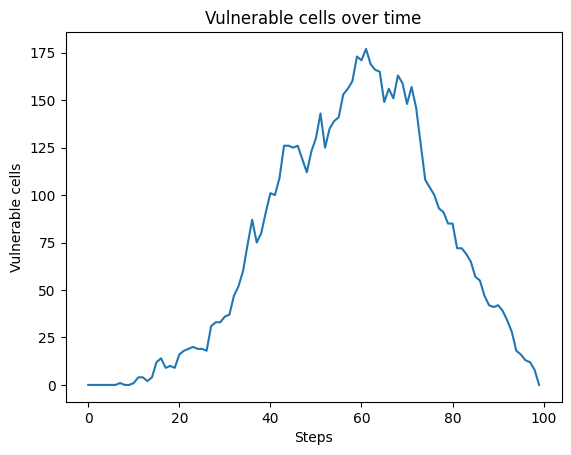

In [ ]:
def count_vulnerable_cells(simulation):
  forest_mask = (simulation.state == simulation.FORESTED).astype(int)
  neighbour_count = correlate2d(forest_mask, simulation.kernel, mode='same', boundary='wrap')
  vulnerable_mask = (simulation.state == simulation.FORESTED) & (neighbour_count < 5)
  vulnerable_count = np.sum(vulnerable_mask)

  return vulnerable_count

simulation = DeforestationModel(n=100)
vulnerable_cells = count_vulnerable_cells(simulation)

vulnerable_history = []

max_steps = 100
for step in range(max_steps):
  simulation.step()
  vulnerable_cells = count_vulnerable_cells(simulation)
  vulnerable_history.append(vulnerable_cells)


plt.plot(np.array(vulnerable_history))
plt.title('Vulnerable cells over time')
plt.xlabel('Steps')
plt.ylabel('Vulnerable cells')


Now, I'll run the model 50 times to gather more reliable data. For each run, I’ll record:

	•	The peak number of vulnerable cells, and
	•	The simulation step at which that peak occurs.

Then, I’ll calculate the average peak value and the average step across all runs. This will give us a better estimate of when the forest typically reaches its most vulnerable state.

In [ ]:
sample_size = 50 # number of simulations

max_vulnerable_cells_history = []
max_step_history = []

for sample in range(sample_size):
  simulation = DeforestationModel(n=100)
  sample_vulnerable_history = np.zeros(max_steps)

  for step in range(max_steps):
    simulation.step()
    vulnerable_cells = count_vulnerable_cells(simulation)
    sample_vulnerable_history[step] = vulnerable_cells

  max_vulnerable_cells = np.max(sample_vulnerable_history)
  max_vulnerable_cells_history.append(max_vulnerable_cells)

  max_step = np.argmax(sample_vulnerable_history)
  max_step_history.append(max_step)


mean_max_vulnerable_cells = np.mean(np.array(max_vulnerable_cells_history))
mean_max_step = np.mean(np.array(max_step_history))

print("Average max vulnerable cells:", mean_max_vulnerable_cells)
print("Average step of max vulnerable cells:", mean_max_step)



Average max vulnerable cells: 172.04
Average step of max vulnerable cells: 63.58


After running 50 simulations, we find that the forest reaches its most fragmented state on average around step 63, with approximately 170 vulnerable cells (i.e., forested cells with fewer than five forested neighbors).

My hypothesis is that this marks the tipping point:

Before this moment, the forest is still connected enough to sustain itself. But as vulnerability peaks, the structure becomes too fragmented to recover. Once the number of vulnerable cells starts to decline, it’s not a sign of recovery. It likely means that the remaining forest is collapsing inward, with isolated patches shrinking. So, I’ll consider this the tipping point.


**How Can We Avoid Total Collapse?**

Imagine scientists finally recognize the crisis—but they’re 5 steps late. In response, a 100% ban on deforestation is enforced, starting 5 steps after the tipping point (i.e., around step 68).

The question is:
**Will this be enough to save what’s left of the forest, or is the collapse already irreversible?**

In [ ]:
deforestation_ban_step = 68

simulate_ban = Animation2D(DeforestationModel(n=100, ban_step=deforestation_ban_step), frames=100)
simulate_ban.show()

It doesn't seem like implementing deforestation ban 5 steps after the tipping point is effective. There's still a green patch of forest left, but it's still shriking. Had there been more steps to the simulation, it would have disspared too.

Now, let's pretend that sicentists realzied the issue early, and they will try saving the forest.

Deforestation ban will occur before the forest is at its most vulnerable state. 5 steps before the average tipping point setp.

Will it be enough to save it?

In [ ]:
deforestation_ban_step = 58

simulate_ban = Animation2D(DeforestationModel(n=100, ban_step=deforestation_ban_step), frames=100)
simulate_ban.show()

Virtually the same result. The green patch is still shrinking by the last step.

So, implementing the ban too close to the tipping point does not seem to be effective.

When would it be effective to implement the deforestation ban then?

In [ ]:
deforestation_ban_step = 50

simulate_ban = Animation2D(DeforestationModel(n=100, ban_step=deforestation_ban_step), frames=100)
simulate_ban.show()

Banning deforestation at step 50 seems more effective. By step 100, there's a lot more forested cells and the grid seems stable.

But let's go through some data to get better results.

Banning deforestation **after** (step 68) the most vulnerable state, on what % of time did that save the forest from  collapse?
(I'm considering  collapse if there's less than 25% of occupied "FORESTED" cells at step 100)

And when banning deforestation **before** (step 58) the most vulnerable state, on what % of the time did that save the forest from collapse?




In [ ]:
def final_occupied_percentage(ban_step, max_steps):
  sample_size = 50
  max_steps = 100
  final_occupied_percentage = []

  for sample in range(sample_size):
    simulation = DeforestationModel(n=100, ban_step=ban_step)
    final_occupied_percentage_history = np.zeros(max_steps)

    for step in range(max_steps):
      simulation.step()
      pct_occupied_cells = simulation.pct_occupied()
      final_occupied_percentage_history[step] = pct_occupied_cells

    min_occupied_cells = np.min(final_occupied_percentage_history)
    final_occupied_percentage.append(min_occupied_cells)


  mean_min_occupied_percentage = np.mean(np.array(final_occupied_percentage)) * 100
  print(f"Deforestation ban at step {ban_step}. Average final % occupied: { mean_min_occupied_percentage:.1f}")
  return mean_min_occupied_percentage

min_occupied_percentage = final_occupied_percentage(68, 100)
min_occupied_percentage = final_occupied_percentage(58, 100)
min_occupied_percentage = final_occupied_percentage(50, 100)

Deforestation ban at step 68. Average final % occupied: 5.9
Deforestation ban at step 58. Average final % occupied: 20.6
Deforestation ban at step 50. Average final % occupied: 41.4


In a 100 steps simulation, banning deforestation 5 steps before or after the forest most vulnerable state wasnt enough to save it in the 50 simulations ran.

Banning at 13 steps before the most vulnerable state was sufficient to save the forest.


In [ ]:
large_deforestation_model = Animation2D(DeforestationModel(n=500), frames=100)
large_deforestation_model.show()